In [1]:
# IMPORTS

import random
from neuron import h, gui
from neuron.units import ms, mV, um, V, cm
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import animation
from tqdm.notebook import tqdm
import csv

from time import time
import os.path

from socket import gethostname

%config InlineBackend.figure_formats = ['svg']

h.load_file('model-files/basal_project.hoc')

1.0

In [2]:
# BARDIA CELL INITIATION (ALTERED)

ratio=0
loc=10
nsyn=0
sec=h.a1_111

dendrec=True

print(f'\n%s .... Starting Run' % (gethostname()))
iotim = 0
tic = time()

h.synrec = 1

h.tsamp = h.tstop/h.dt+1
h.synrec = 1
tsamp = int(h.tsamp)

r = h.Random(h.luckyoffset)
r.negexp(h.meanisi)

# h.a1_111.nseg = int(np.floor(h.a1_111.L))
# h.a1_111.nseg = int(np.floor(h.a1_111.L)/2)
seclist = [h.a1_111,
           h.a9_122,
           h.a10_11,
           h.a5_1,
           h.a8_11,
           h.a3_11,
           h.a9_122,
           h.a9_121,
           h.a8_122,
           h.a8_121,
           h.a7_111]

sl2 = h.SectionList()
for sec in seclist:
    sl2.append(sec = sec)
poppedsecs = sl2.unique()
h.refreshnseg(h.makeactivelist(sl2))
print(f'nseg: %d' % (h.nsegcnt()))
h.cvode.cache_efficient(1)
h.cvode_active(0)
h.poisson = 0


Christophers-MacBook-Pro.local .... Starting Run
nseg: 787


In [4]:
######################### BIOPHYSICAL FUNCTIONS #########################

def add_spines(branches):
    
    """
    Adds spines to all branches within the branch list
    5 spines per segment on each branch
    
    Returns nested list of spines within each branch 
    """
    
    # Intialize vectors for the spine head/neck
    spine_head = []
    spine_neck = []
    
    # Iterates through the number of branches of interest (list)
    num_branch = len(branches)
    for j in range(num_branch):
        
        
        # branches[j].nseg = int((np.floor(branches[j].L)) / 4)
        spine_head_temp = []
        spine_neck_temp = []

        # Number of spines: 5 per segment
        n_spines = branches[j].nseg * 5

        # Iterate through the number of spines for the particular branch
        for i in range(n_spines):
            
            # Create head and neck biophysical parameters
            spine_head_temp.append(h.Section())
            spine_neck_temp.append(h.Section())

            spine_head_temp[-1].L = 0.5
            spine_head_temp[-1].diam = 0.5
            spine_head_temp[-1].Ra = 100
            spine_head_temp[-1].insert('pas')
            for seg in spine_head_temp[-1]:
                seg.pas.e = -70
                seg.pas.g = 0.00005

            spine_neck_temp[-1].L = 1.5
            spine_neck_temp[-1].diam = 0.25
            spine_neck_temp[-1].Ra = 100
            spine_neck_temp[-1].insert('pas')
            for seg in spine_neck_temp[-1]:
                seg.pas.e = -70
                seg.pas.g = 0.00005
    
            # Connect head and neck together; then connect neck to branch
            spine_neck_temp[-1].connect(branches[j]((i+1)/n_spines))
            spine_head_temp[-1].connect(spine_neck_temp[-1])
        
        
        spine_head.append(spine_neck_temp)
        spine_neck.append(spine_head_temp)
    
    return spine_neck, spine_head

def add_inhib_soma(num):
    """
    Adds GABA synapses to the soma
    num: number of synapses
    
    Returns list of GABA synapses on the soma

    """

    syn_gaba_soma = []
    for i in range(num):
        syn_gaba_soma.append(h.GABAa_S(h.soma(0.5)))
        
    return syn_gaba_soma
    
def add_syn(branches, inhib=False):
    
    """
    Adds AMPA, NMDA, and GABA synaptic channels to a list of branches
    branches: list of branches
    inhib: boolean, determines if inhibitory synapses will be added to the branches
    
    Returns three nested vectors containing the synapses
    """

    syn_ampa = []
    syn_nmda = []
    syn_gaba = []
    
    num_branch = len(branches)
    
    # Iterates through the number of branches and applies synapses to every spine
    for j in range(num_branch):
        
        syn_ampa_temp = []
        syn_nmda_temp = []
        syn_gaba_temp = []
        
        # Indexes spine heads of the current branch
        n_spines = len(spine_head[j])
        for i in range(n_spines):
            
            # adds AMPA, NMDA, and GABA synapses to each spine
            syn_ampa_temp.append(h.Exp2Syn(spine_head[j][i](0.5)))
            syn_nmda_temp.append(h.Exp2SynNMDA(spine_head[j][i](0.5)))
            syn_ampa_temp[-1].e = 0
            syn_ampa_temp[-1].tau1 = 0.05
            syn_ampa_temp[-1].tau2 = 0.5
            syn_nmda_temp[-1].e = 0
            syn_nmda_temp[-1].tau1 = 2.1
            syn_nmda_temp[-1].tau2 = 18.8
            # syn_nmda_temp[-1].tau2 = 10
            
            if inhib:
                syn_gaba_temp.append(h.GABAa_S(spine_head[j][i](0.5)))
            
        syn_ampa.append(syn_ampa_temp)
        syn_nmda.append(syn_nmda_temp)
        syn_gaba.append(syn_gaba_temp)
    
    return syn_ampa, syn_nmda, syn_gaba

######################### CURRENT INJECTIONS ############################

def frequency_counter(t_vec, v_vec):
    """
    Returns the frequency of spikes measured at the soma
    
    t_vec: time vector
    v_vec: voltage vector
    
    """
    
    # Chops off the first 100ms, in which the model is still reaching steady-state
    t_tot = t_vec[-1]
    start_t_i = np.where(np.floor(t_vec)==100)[0][0]
    
    spike_counter = 0
    length_v = len(v_vec)
    
    # Iterates from 100ms to end of time for the vector; calculates spikes
    for i in range(start_t_i, length_v-1):
        if v_vec[i] < 0 and v_vec[i+1] >= 0:
            spike_counter += 1
    
    # Determines the frequency of spikes
    frequency = (spike_counter/(t_tot-100)) * 10 ** 3
    
    return frequency

##################### SYNAPSE BEHAVIOR ##########################

def background_simulation(branches, 
                          n_gaba,
                          g,
                          firing=50,
                          dtb=3):
    
    """
    Simulates background synapses along basal dendrites,
    in which the soma has basket cell-like inhibitory synapses
    
    Firing rate is fixed to 5 Hz with a Guassian distribution of start times
    
    branches: list of branches
    n_gaba: number of GABA synapses at the soma
    g: conductance of GABA synapses (µS)
    firing: firing rate of GABA-gamma synapses [50 Hz default]
    dtb: std of distribution for firing rates [Hz]
    dendrite_gaba: determines if GABA synapses are added to the basal dendrites
    distance: determines the distance GABA synapses are added to basal dendrites (can be decimal or exact value)
    """
    
    # GABA Stimulations; all fire at 5 Hz (no noise) at Gaussian-distributed start times
    syn_stim_gaba = []
    
    # Determine interval between GABA synapses (dt)
    interval_gaba = 1000/firing
    
    # Calculates number of times GABA fires within time period
    num_firing = int(np.floor(h.tstop/interval_gaba))

    # Iterates through GABA firing
    for i in range(num_firing+1):
        
        # For each synapse, generates distribution of firing for each time point
        gaba_start_distribution = np.random.normal(0, dtb, n_gaba)

        # Iterate through all firing instances for each synapse
        for j in range(n_gaba):
            syn_stim_gaba.append(create_stim(interval=interval_gaba,
                                                      num=1,
                                                      start=gaba_start_distribution[j]+interval_gaba*i,
                                                      noise=0,
                                                      s=1))
    
    ncstim=[]
    
    # Iterate through GABA firing periods
    for q in range(num_firing+1):
        
        n_s = 0 # Number of synapses
        
        # Iterate through the number of synapses, then shift the firing period
        while n_s < n_gaba:

            # Append firing instances to SOMA GABA synapses
            ncstim.append(h.NetCon(syn_stim_gaba[n_s+q*n_gaba], syn_gaba_soma[n_s], 0, 0, g))
            n_s += 1
    
    return ncstim, syn_stim_gaba


def create_stim(interval=10, num=3, start=5, noise=0, s=1):
    
    """
    Creates a stimulator object used as the pre-synaptic stimulus
    interval: amount of time between stimulation events (ms)
    num: the number of stimulation events
    start: delay of stimulation (ms)
    s: seed number
    """
    
    stim = h.NetStim()
    stim.interval = interval
    stim.number = num
    stim.start = start
    stim.noise = noise

    if s == 1:
        stim.seed(np.random.randint(1000000))
    else:
        stim.seed(s)
    
    return stim

def generate_traces(branch,
                    measure,
                    loc,
                    n_syn,
                    stim_obj,
                    g,
                    spread,
                    adj,
                    adj_var=0,
                    avg=1,
                    n_gaba=40,
                    g_bg=0,
                    firing=50,
                    dtb=3,
                    distribute=False,
                    sync=False,
                    stim_spread=0,
                    file_path=""):
    
    """
    Applies a number of synapses at a specified location, giving a stimulus object
    Can be used to look at voltage traces of synapses, typically with a background current
    
    branch: branch being activated
    measure: branch(loc) where voltage is recorded from
    loc: location of applied synapses along dendrite (decimal)
    n_syn: number of synapses being applied to branch
    stim_obj: stimulation parameters
    g: conductance of AMPA/NMDA
    spread: how far apart synapses are (index based)
    sync: determines whether all synapses fire synchronously
    stim_spread: temporal shift between each synapse
    """
    
    # Output the location of stimulus
    loc_n = int(np.floor(len(syn_ampa[0])*loc))
    loc_um = int(np.floor(branch.L*loc))
    print('Applying synapses at ~' + str(loc_um) + ' um (' + str(branch.L) + ' um total)')
    
    nc_excit = []
    syn_stims = []

    ## APPLY CURRENT INJECTION ######################################################################
    adjust, stim_obj_i, current, tt = current_injection(amp=adj, var=adj_var)

    ## CREATES EXCITATORY STIMULUS (NETSTIM) ########################################################
    # If synchronous, only one stimulus object is created for ALL synapses
    if sync:
        syn_stims.append(create_stim(interval=stim_obj[0],
                                         num=stim_obj[1],
                                         start=stim_obj[2],
                                         noise=stim_obj[3],
                                         s=stim_obj[4]))
    
    # If not synchronous, all synapses recieve their own stim object
    else:
        for i in range(n_syn):
            syn_stims.append(create_stim(interval=stim_obj[0],
                                         num=stim_obj[1],
                                         start=stim_obj[2]+stim_spread*i,
                                         noise=stim_obj[3],
                                         s=stim_obj[4]))
        
    # APPLY EXCITATORY (AMPA/NMDA) SYNAPSES AT DENDRITE (NETCON) #####################################
    if n_syn != 0:
        
        for i in tqdm(range(n_syn)):
            j=i
            if sync:
                j=0
                
            if distribute:
                loc_n = np.floor(random.random() * len(syn_ampa[0]))
                
            nc_excit.append(h.NetCon(syn_stims[j], syn_ampa[0][loc_n+spread*i], 0, 0, g[0]))
            nc_excit.append(h.NetCon(syn_stims[j], syn_nmda[0][loc_n+spread*i], 0, 0, g[1])) # gMax

    ## APPLY INHIBITORY SYNAPSES AT SOMA ##############################################################
    nc_inhib = None
    nc_inhib, syn_stim_gaba = background_simulation(basal_dendrites,
                                                   n_gaba=n_gaba,
                                                   g=g_bg,
                                                   firing=firing,
                                                   dtb=dtb)
        
    ## RECORD CONDUCTANCE TRACES ######################################################################
    ampa_g_array = []
    nmda_g_array = []
    gaba_g_array = []
    
    for syn in syn_ampa[0]:
        ampa_g_array.append(h.Vector().record(syn._ref_g))

    for syn in syn_nmda[0]:
        nmda_g_array.append(h.Vector().record(syn._ref_g))

    for syn in syn_gaba_soma:
        gaba_g_array.append(h.Vector().record(syn._ref_g))

    ## RECORD SPIKE TIMES ##############################################################################

    if n_syn != 0:
        if sync:
            spike_times_excit = h.Vector()
            nc_excit[0].record(spike_times_excit)
        else:
            spike_times_excit = [h.Vector() for nc in nc_excit]
            for nc, spike_times_vec in zip(nc_excit, spike_times_excit):
                nc.record(spike_times_vec)
    else:
        spike_times_excit = []
    
    spike_times_inhib = [h.Vector() for nc in nc_inhib]
    for nc, spike_times_vec in zip(nc_inhib, spike_times_inhib):
        nc.record(spike_times_vec)

    ## RUN SIMULATION ###################################################################################
    dend_v = h.Vector().record(h.a1_111(0.5)._ref_v)
    soma_v = h.Vector().record(h.soma(0.5)._ref_v)
    t_vec = h.Vector().record(h._ref_t)
    h.finitialize()
    h.run()
    
    # Convert all vectors to NUMPY arrays
    t_vec = list(t_vec)
    soma_v = list(soma_v)
    dend_v = list(dend_v)
    ampa_g_array = np.array(ampa_g_array)
    nmda_g_array = np.array(nmda_g_array)
    gaba_g_array = np.array(gaba_g_array)

    temp_array = [[] for i in range(n_gaba)]
    n_s = 0
    for spike in spike_times_inhib:
        if n_s >= n_gaba:
            n_s = 0
            
        if np.size(list(spike)) != 0:
            temp_array[n_s].append(list(spike)[0])
        else:
            temp_array[n_s].append(-1)
        n_s += 1
    spike_times_inhib = np.array(temp_array)

    if not sync:
        spike_times_excit = [list(e) for i, e in enumerate(spike_times_excit) if i % 2]      
    
    total_ampa_g = np.sum(ampa_g_array, axis=0)
    total_nmda_g = np.sum(nmda_g_array, axis=0)
    total_gaba_g = np.sum(gaba_g_array, axis=0)
     
    # CALCULATE SOMATIC FREQUENCY ########################################################################
    f = frequency_counter(t_vec, soma_v)
    print("Frequency: " + str(f) + " Hz")

    ## PLOTTING TRACES ###################################################################################

    x_bound_1 = 100
    x_bound_2 = 200
    
    plt.rcParams['xtick.labelsize'] = 14
    plt.rcParams['ytick.labelsize'] = 14
  
    plt.figure(1)
    fig, axs = plt.subplots(6, sharex=True, figsize=(10, 14))
    axs[0].plot(t_vec, soma_v, "k")
    axs[0].plot(t_vec, dend_v, "royalblue")
    axs[0].set_xlim(x_bound_1, x_bound_2)
    axs[0].set_ylabel('$V_{m}$ (mV)', fontsize=14)
    axs[0].legend(["Soma", "Dendrite"])
    axs[0].grid(visible=True, which='major')

    axs[1].plot(t_vec, adjust, "purple")
    axs[1].set_xlim(x_bound_1, x_bound_2)
    axs[1].set_ylabel('Current Injection (nA)', fontsize=14)
    axs[1].grid(visible=True, which='major')
    
    axs[2].plot(t_vec, total_gaba_g, "orangered")
    axs[2].set_xlim(x_bound_1, x_bound_2)
    axs[2].set_ylabel("$g_{Inhib}$ (µS)", fontsize=14)
    axs[2].grid(visible=True, which='major')
    
    axs[3].plot(t_vec, total_ampa_g, "y")
    axs[3].plot(t_vec, total_nmda_g, "limegreen")
    axs[3].set_xlim(x_bound_1, x_bound_2)
    axs[3].grid(visible=True, which='major')
    axs[3].legend(["$g_{AMPA}$", "$g_{NMDA}$"])
    axs[3].set_ylabel("$g_{Excit}$ (µS)", fontsize=14)
    
    axs[4].eventplot(spike_times_inhib, orientation='horizontal', lineoffsets=1,linelengths=1, colors="orangered")
    if sync:
        axs[4].eventplot(spike_times_excit, lineoffsets=n_gaba/2, linelengths=n_gaba, colors="limegreen")
    else:
        axs[4].eventplot(spike_times_excit, orientation='horizontal', lineoffsets=1,linelengths=1, colors="limegreen")
        
    axs[4].set_xlim(x_bound_1, x_bound_2)
    axs[4].set_ylabel("Synapse ID", fontsize=14)
    axs[4].set_ylim(0, n_gaba)
    axs[4].grid(visible=True, which='major')
    axs[4].legend(["Inhibition", "Excitation"])
    leg = axs[4].get_legend()
    leg.legendHandles[0].set_color('orangered')
    leg.legendHandles[1].set_color('limegreen')

    binwidth = 1
    axs[5].hist(spike_times_inhib.flatten(), bins=range(x_bound_1, x_bound_2 + binwidth, binwidth), rwidth=1, color="orangered")
    if sync:
        axs[5].hist(np.tile(spike_times_excit, 10), bins=range(x_bound_1, x_bound_2 + binwidth, binwidth), rwidth=1, color="limegreen")
    else:
        axs[5].hist(flatten(spike_times_excit), bins=range(x_bound_1, x_bound_2 + binwidth, binwidth), rwidth=1, color="limegreen")
    axs[5].set_xlabel("Time (ms)", fontsize=14)
    axs[5].set_ylabel("Synapse Count", fontsize=14)
    axs[5].legend(["Inhibition", "Excitation"])
    axs[5].grid(visible=True, which='major')

    ## SAVE DATA AND PLOTS

    if file_path != "":

        # SAVE DATA
        voltage_file = file_path + "-voltage-trace.csv"
        voltage_data = np.vstack((t_vec, soma_v, dend_v)).T
        np.savetxt(voltage_file, voltage_data, delimiter=', ')

        current_file = file_path + "-i-inject-trace.csv"
        current_data = np.vstack((t_vec, adjust)).T
        np.savetxt(current_file, current_data, delimiter=', ')

        g_inhib_file = file_path + "-g-inhib-trace.csv"
        g_inhib_data = np.vstack((t_vec, total_gaba_g)).T
        np.savetxt(g_inhib_file, g_inhib_data, delimiter=', ')
        
        g_excit_file = file_path + "-g-excit-trace.csv"
        g_excit_data = np.vstack((t_vec, total_ampa_g, total_nmda_g)).T
        np.savetxt(g_excit_file, g_excit_data, delimiter=', ')

        spike_inhib_file = file_path + "-inhib-spikes.csv"
        with open(spike_inhib_file, 'w', newline='') as f:
            write = csv.writer(f, delimiter=',')
            for i in spike_times_inhib:
                write.writerow(i)

        spike_excit_file = file_path + "-excit-spikes.csv"
        if not sync:
            with open(spike_excit_file, 'w', newline='') as f:
                write = csv.writer(f, delimiter=',')
                for i in spike_times_excit:
                    write.writerow(i)
        else:
            np.savetxt(spike_excit_file, spike_times_excit, delimiter=', ')

        # SAVE PLOTS
        full_fig_file = file_path + "-total-trace-plot.svg"
        fig.savefig(full_fig_file)

        fig, ax = plt.subplots(figsize=(12, 4))
        ax.plot(t_vec, soma_v, "k")
        ax.plot(t_vec, dend_v, "royalblue")
        ax.set_xlim(x_bound_1, x_bound_2)
        ax.set_ylabel('$V_{m}$ (mV)', fontsize=14)
        ax.set_xlabel('Time (ms)', fontsize=14)
        ax.legend(["Soma", "Dendrite"])
        ax.grid(visible=True, which='major')

        voltage_fig_file = file_path + "-voltage-plot.svg"
        fig.savefig(voltage_fig_file)

        fig, ax = plt.subplots(figsize=(12, 4))
        ax.plot(t_vec, adjust, "purple")
        ax.set_xlim(x_bound_1, x_bound_2)
        ax.set_ylabel('Current Injection (nA)', fontsize=14)
        ax.set_xlabel('Time (ms)', fontsize=14)
        ax.grid(visible=True, which='major')

        current_fig_file = file_path + "-i-inject-plot.svg"
        fig.savefig(current_fig_file)

        fig, ax = plt.subplots(figsize=(12, 4))
        ax.plot(t_vec, total_gaba_g, "orangered")
        ax.set_xlim(x_bound_1, x_bound_2)
        ax.set_ylabel("$g_{Inhib}$ (µS)", fontsize=14)
        ax.set_xlabel('Time (ms)', fontsize=14)
        ax.grid(visible=True, which='major')

        g_inhib_fig_file = file_path + "-g-inhib-plot.svg"
        fig.savefig(g_inhib_fig_file)

        fig, ax = plt.subplots(figsize=(12, 4))
        ax.plot(t_vec, total_ampa_g, "y")
        ax.plot(t_vec, total_nmda_g, "limegreen")
        ax.set_xlim(x_bound_1, x_bound_2)
        ax.grid(visible=True, which='major')
        ax.legend(["$g_{AMPA}$", "$g_{NMDA}$"])
        ax.set_ylabel("$g_{Excit}$ (µS)", fontsize=14)
        ax.set_xlabel('Time (ms)', fontsize=14)

        g_excit_fig_file = file_path + "-g-excit-plot.svg"
        fig.savefig(g_excit_fig_file)

        fig, ax = plt.subplots(figsize=(12, 4))
        ax.eventplot(spike_times_inhib, orientation='horizontal', lineoffsets=1,linelengths=1, colors="orangered")
        if sync:
            ax.eventplot(spike_times_excit, lineoffsets=n_gaba/2, linelengths=n_gaba, colors="limegreen")
        else:
            ax.eventplot(spike_times_excit, orientation='horizontal', lineoffsets=1,linelengths=1, colors="limegreen")
            
        ax.set_xlim(x_bound_1, x_bound_2)
        ax.set_ylabel("Synapse ID", fontsize=14)
        ax.set_xlabel('Time (ms)', fontsize=14)
        ax.set_ylim(0, n_gaba)
        ax.grid(visible=True, which='major')
        ax.legend(["Inhibition", "Excitation"])
        leg = ax.get_legend()
        leg.legendHandles[0].set_color('orangered')
        leg.legendHandles[1].set_color('limegreen')

        raster_file = file_path + "-spike-raster-plot.svg"
        fig.savefig(raster_file)

        fig, ax = plt.subplots(figsize=(12, 4))
        binwidth = 1
        ax.hist(spike_times_inhib.flatten(), bins=range(x_bound_1, x_bound_2 + binwidth, binwidth), rwidth=1, color="orangered")
        if sync:
            ax.hist(np.tile(spike_times_excit, 10), bins=range(x_bound_1, x_bound_2 + binwidth, binwidth), rwidth=1, color="limegreen")
        else:
            ax.hist(flatten(spike_times_excit), bins=range(x_bound_1, x_bound_2 + binwidth, binwidth), rwidth=1, color="limegreen")
        ax.set_xlabel("Time (ms)", fontsize=14)
        ax.set_ylabel("Synapse Count", fontsize=14)
        ax.legend(["Inhibition", "Excitation"])
        ax.grid(visible=True, which='major')

        hist_file = file_path + "-hist-plot.svg"
        fig.savefig(hist_file)
        
    ## CLEAR POINT PROCESSES ###################################################################################
    nc_inhib = None
    nc_excit = None
    syn_stims = None
    syn_stim_gaba = None
    adjust = None
    stim_obj_i = None
    current = None
    tt = None
    
    return f, soma_v, t_vec

def steady_gaba_conductance(g):
    steady_synapse = h.GABAa_S(h.soma(0.5))
    syn_stim_steady = create_stim(interval=0,
                                    num=1e9,
                                    start=0,
                                    noise=0,
                                s=2)
    ncstim_steady = (h.NetCon(syn_stim_steady, steady_synapse, 0, 0, g))
    return ncstim_steady, steady_synapse, syn_stim_steady

def current_injection(amp, var):
    tt = h.Vector(np.linspace(0, h.tstop, int(h.tstop/h.dt + 1)))
    current = np.random.normal(amp, var, len(tt))
    
    adjust = h.Vector()
    adjust.from_python(current)
    stim_obj = h.IClamp(h.soma(0.5))
    stim_obj.delay = 0  # ms
    stim_obj.dur = 1e9  # ms
    adjust.play(stim_obj._ref_amp, tt, True)
    return adjust, stim_obj, current, tt

def flatten(xss):
    if isinstance(xss, float):
        return xss
    else:
        return [x for xs in xss for x in xs]

In [5]:
basal_dendrites = [h.a1_111,
                   h.a9_122,
                   h.a10_11,
                   h.a5_1,
                   h.a8_11,
                   h.a3_11,
                   h.a9_122,
                   h.a9_121,
                   h.a8_122,
                   h.a8_121,
                   h.a7_111]

In [6]:
n_gaba = 30

spine_neck, spine_head = add_spines(basal_dendrites)
syn_ampa, syn_nmda, syn_gaba = add_syn(basal_dendrites, inhib=True)
syn_gaba_soma = add_inhib_soma(n_gaba)

Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz


/var/folders/gn/nmp7t3s51b34z7c2mk853cr40000gn/T/ipykernel_6875/2524181728.py:438: MatplotlibDeprecationWarning: The legendHandles attribute was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use legend_handles instead.
  leg.legendHandles[0].set_color('orangered')
/var/folders/gn/nmp7t3s51b34z7c2mk853cr40000gn/T/ipykernel_6875/2524181728.py:439: MatplotlibDeprecationWarning: The legendHandles attribute was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use legend_handles instead.
  leg.legendHandles[1].set_color('limegreen')


Applying synapses at ~121 um (243.8985804846295 um total)


/var/folders/gn/nmp7t3s51b34z7c2mk853cr40000gn/T/ipykernel_6875/2524181728.py:550: MatplotlibDeprecationWarning: The legendHandles attribute was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use legend_handles instead.
  leg.legendHandles[0].set_color('orangered')
/var/folders/gn/nmp7t3s51b34z7c2mk853cr40000gn/T/ipykernel_6875/2524181728.py:551: MatplotlibDeprecationWarning: The legendHandles attribute was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use legend_handles instead.
  leg.legendHandles[1].set_color('limegreen')


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 1.0000000000004527 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


/var/folders/gn/nmp7t3s51b34z7c2mk853cr40000gn/T/ipykernel_6875/2524181728.py:536: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(12, 4))


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 1.0000000000004527 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 1.0000000000004527 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 1.0000000000004527 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 2.0000000000009055 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 2.0000000000009055 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 5.000000000002264 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 7.000000000003169 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 7.000000000003169 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 6.000000000002716 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 5.000000000002264 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 4.000000000001811 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 3.000000000001358 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 2.0000000000009055 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 2.0000000000009055 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 1.0000000000004527 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 1.0000000000004527 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 1.0000000000004527 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 1.0000000000004527 Hz
Applying synapses at ~121 um (243.8985804846295 um total)
Frequency: 0.0 Hz
Applying synapses at ~121 um (243.8985804846295 um total)


  0%|          | 0/12 [00:00<?, ?it/s]

Frequency: 1.0000000000004527 Hz


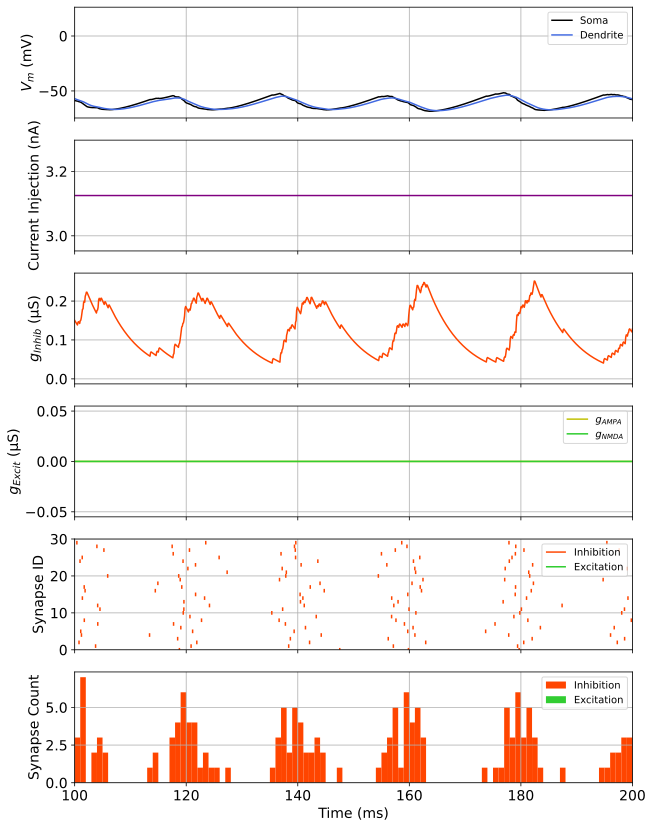

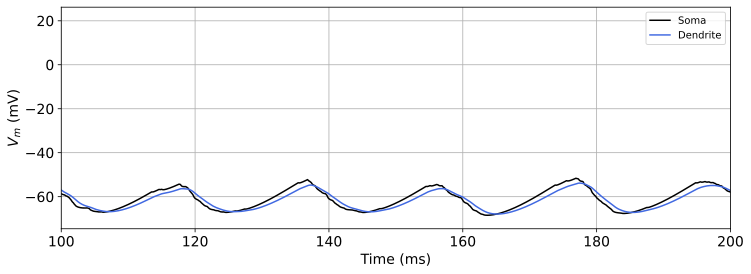

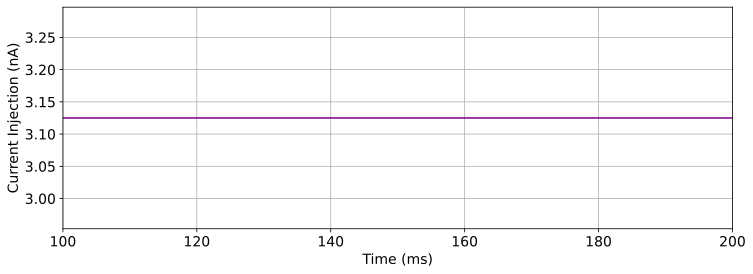

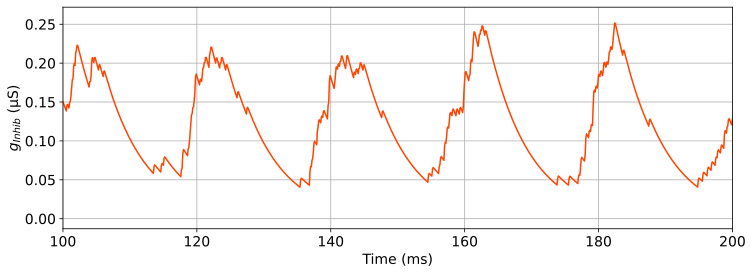

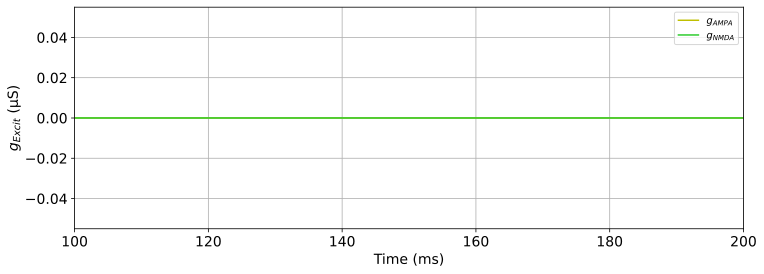

...

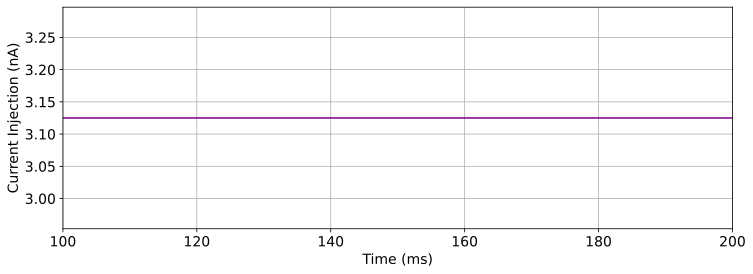

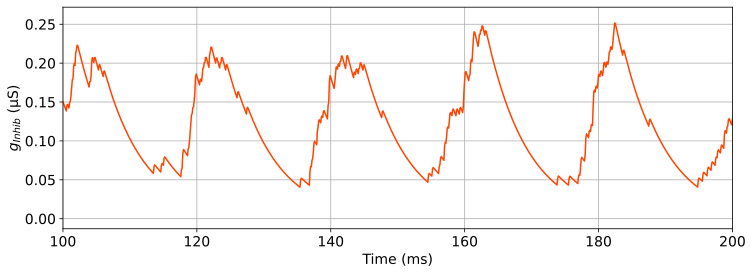

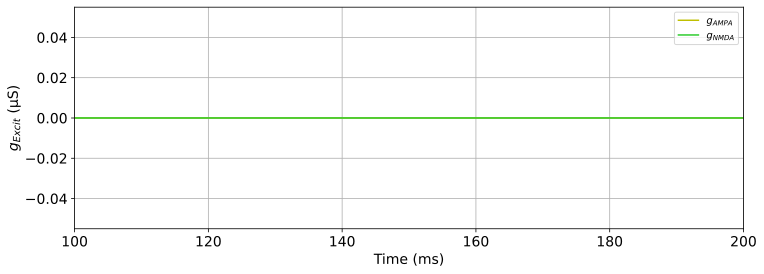

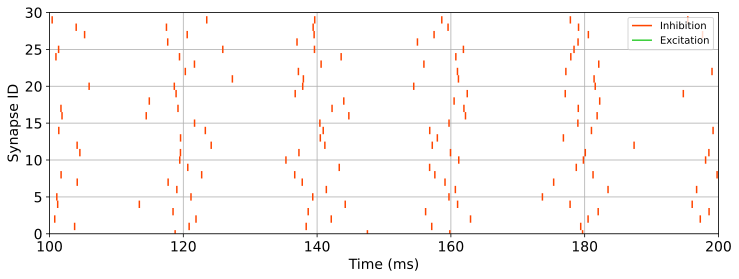

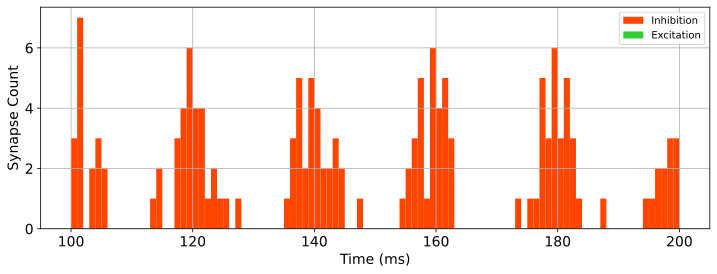

<Figure size 640x480 with 0 Axes>

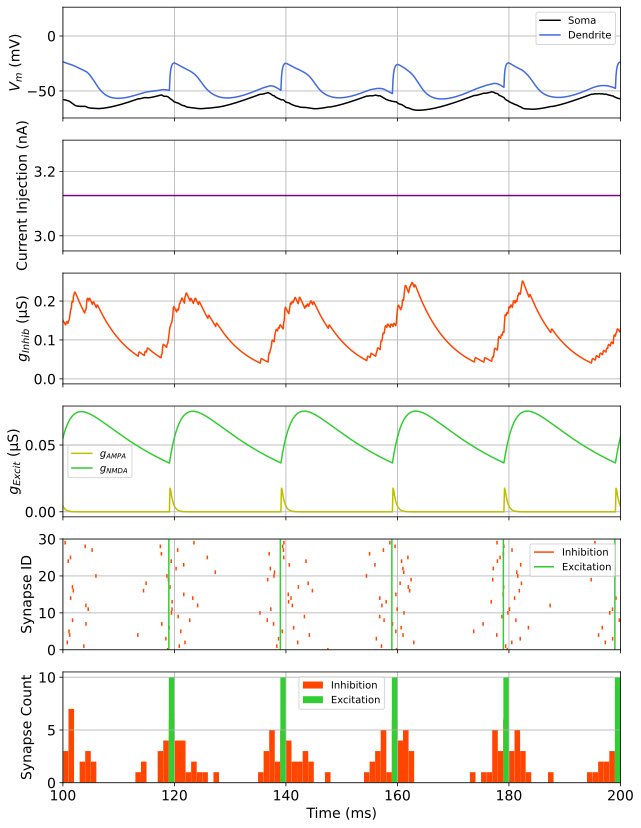

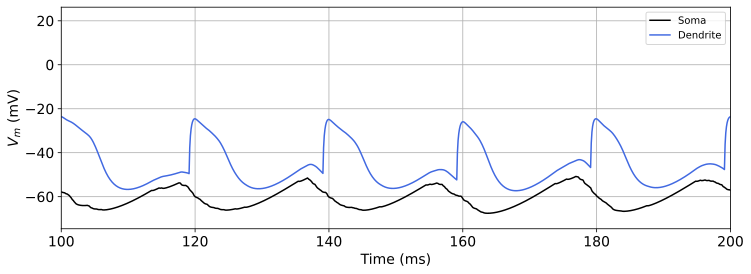

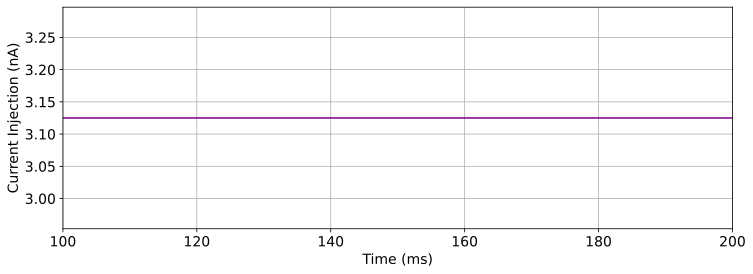

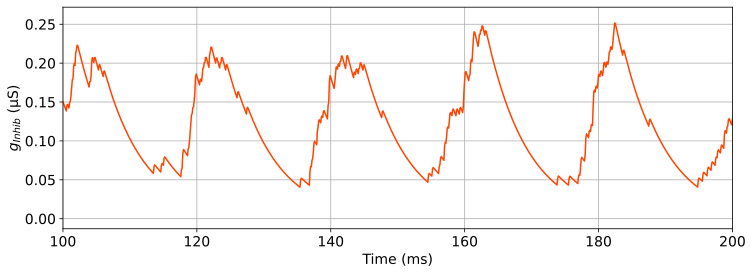

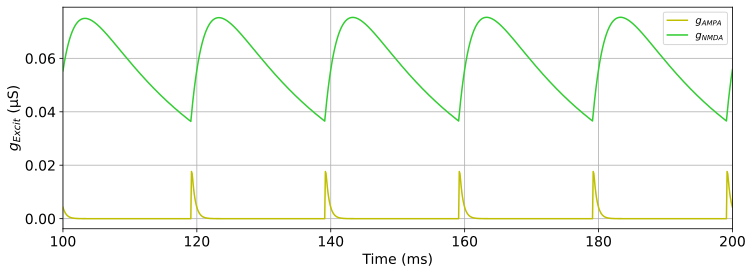

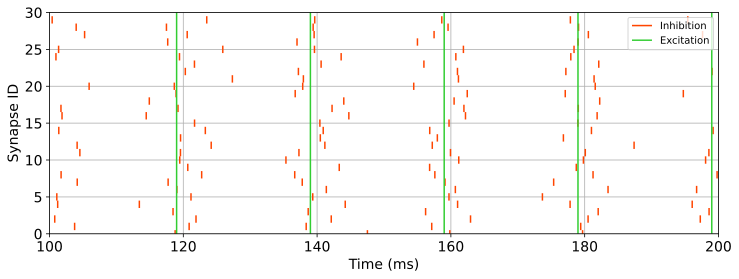

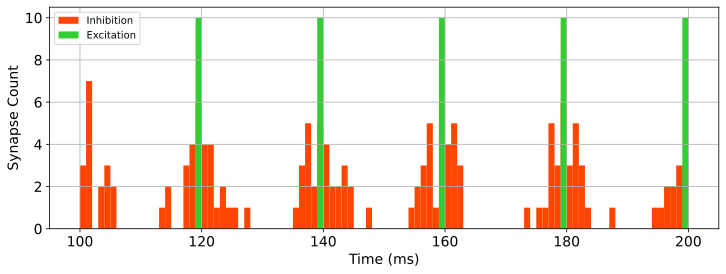

In [7]:
# NOTE: MUST CLEAR NCSTIM_, otherwise, there is OVERLAP!
ncstim_ = None

# np.random.seed(1)

## SINUSOIDAL CURRENT INJECTION 
# xx = h.Vector(np.linspace(0, h.tstop, int(h.tstop/h.dt)))
# t = np.linspace(0, h.tstop, int(h.tstop/h.dt))
# current_ = 1.9 + 0.5*np.sin(2*np.pi/20*t)
# i_c_ = h.Vector()
# i_c_.from_python(current_)
# stim_obj_ = h.IClamp(h.soma(0.5))
# stim_obj_.delay = 0  # ms
# stim_obj_.dur = 1e9  # ms
# i_c_.play(stim_obj_._ref_amp, xx, True)

# Apply synapses and analyze voltage traces
h.tstop = 1100

# Number of synapses being applied to the cell
num_s = 40

for t_offset in range(20):
    for n_syn_i in [0, 12]:
        np.random.seed(1)
        num_s = n_syn_i

        f_path = "SLURM-jobs/timing-variation/timing-traces/0-015-conductance/t-offset-" + str(t_offset) + "-n-syn-" + str(num_s)
        # f_path = ""
        
        # stim_param = [interval, num, start, noise, seed]
        stim_param =  [1000/50,  1e9,   t_offset,     0,     2]
        
        f, volt, time = generate_traces(branch=h.a1_111,
                                          measure=h.soma(0.5),
                                          loc=0.5,       
                                          n_syn=num_s,
                                          stim_obj=stim_param,
                                          g=[0.0015, 0.0039],
                                          spread=0,
                                          adj=3.125,
                                          adj_var=0,
                                          n_gaba=30,
                                          g_bg=0.015,
                                          firing=50,
                                          dtb=3,
                                          distribute=False,
                                          sync=True,
                                          stim_spread=0,
                                          file_path=f_path)
        
        adjust = None
        tt = None
        xx = None
        current = None
        current_ = None
        i_c = None
        i_c_ = None
        stim_obj = None
        stim_obj_ = None
        ncstim_ = None
        tt = None
        syn_stim_gaba = None
        ncstim_steady = None
        steady_synapse = None